In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import h5py
import os

/home/apk/anaconda2/lib/python2.7/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters


In [2]:
efile=['ME_1_R_2019.01.04_12.43.04.hdf5','ME_2_R_2019.01.04_12.46.47.hdf5','ME_4_R_2019.01.04_12.50.25.hdf5',
       'ME_5_R_2019.01.04_12.54.01.hdf5','ME_9_R_2019.01.04_12.57.10.hdf5','ME_10_R_2019.01.04_13.00.14.hdf5',
       'ME_11_R_2019.01.04_13.03.14.hdf5','ME_13_R_2019.01.04_13.06.04.hdf5','ME_14_a_R_2019.01.04_13.07.38.hdf5',
       'ME_14_b_R_2019.01.04_13.08.50.hdf5','ME_14_c_R_2019.01.04_13.10.00.hdf5','ME_14_d_R_2019.01.04_13.11.13.hdf5',
       'ME_15_R_2019.01.04_13.12.49.hdf5','ME_19_R_2019.01.04_13.14.15.hdf5','MI_1_2019.01.04_12.40.57.hdf5',
       'MI_2_2019.01.04_12.44.37.hdf5','MI_4_2019.01.04_12.48.21.hdf5','MI_5_2019.01.04_12.51.57.hdf5',
       'MI_9_2019.01.04_12.55.25.hdf5','MI_10_2019.01.04_12.58.41.hdf5','MI_11_2019.01.04_13.01.51.hdf5',
       'MI_13_2019.01.04_13.04.41.hdf5']

In [3]:
for f in efile:
    eeg=h5py.File(f,mode='r')
    print f
    sampletime = np.array(eeg['AsynchronData']["Time"])
    
    sampletime1=np.delete(sampletime, len(sampletime)-1)
    sampletime1=np.delete(sampletime1, 0)
    if len(sampletime)==1:
        sampletime1=sampletime
    if sampletime1[0]/256.0 <=3.0:
        print 'ooh'
        print sampletime1[0]/256.0
    #print (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0
    if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <6.0:
        print 'noooo'
        print (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0

ME_1_R_2019.01.04_12.43.04.hdf5
ME_2_R_2019.01.04_12.46.47.hdf5
ME_4_R_2019.01.04_12.50.25.hdf5
ME_5_R_2019.01.04_12.54.01.hdf5
ME_9_R_2019.01.04_12.57.10.hdf5
ME_10_R_2019.01.04_13.00.14.hdf5
ME_11_R_2019.01.04_13.03.14.hdf5
ME_13_R_2019.01.04_13.06.04.hdf5
ME_14_a_R_2019.01.04_13.07.38.hdf5
ME_14_b_R_2019.01.04_13.08.50.hdf5
noooo
5.97265625
ME_14_c_R_2019.01.04_13.10.00.hdf5
ME_14_d_R_2019.01.04_13.11.13.hdf5
ME_15_R_2019.01.04_13.12.49.hdf5
ME_19_R_2019.01.04_13.14.15.hdf5
MI_1_2019.01.04_12.40.57.hdf5
MI_2_2019.01.04_12.44.37.hdf5
MI_4_2019.01.04_12.48.21.hdf5
MI_5_2019.01.04_12.51.57.hdf5
MI_9_2019.01.04_12.55.25.hdf5
MI_10_2019.01.04_12.58.41.hdf5
MI_11_2019.01.04_13.01.51.hdf5
MI_13_2019.01.04_13.04.41.hdf5


In [9]:
import scipy.signal as signal
def butter_bandpass(lowcut, fs, order):
    nyq = 0.5 * fs
    low = lowcut / nyq
    
    b, a = signal.butter(order, low, btype='low')
    return b, a

In [5]:
def CAR(samples):
    s=[]
    for i in range(0, len(samples)):
        s.append((sum(samples))/64.0)
    
    sample=samples-s
    return sample, s


In [6]:
from scipy import sparse
from scipy.sparse.linalg import spsolve
def baseline_als(y, lam, p, niter=10):
    L = len(y)
    D = sparse.diags([1,-2,1],[0,-1,-2], shape=(L,L-2))
    #D = sparse.csc_matrix(np.diff(np.eye(L), 2))
    w = np.ones(L)
    for i in range(niter):
        W = sparse.spdiags(w, 0, L, L)
        Z = W + lam * D.dot(D.transpose())
        z = spsolve(Z, w*y)
        w = p * (y > z) + (1-p) * (y < z)
    return z

In [7]:
plt.rcParams["figure.figsize"] = [25,16]
path='id6Day90-20190503T213214Z-001'

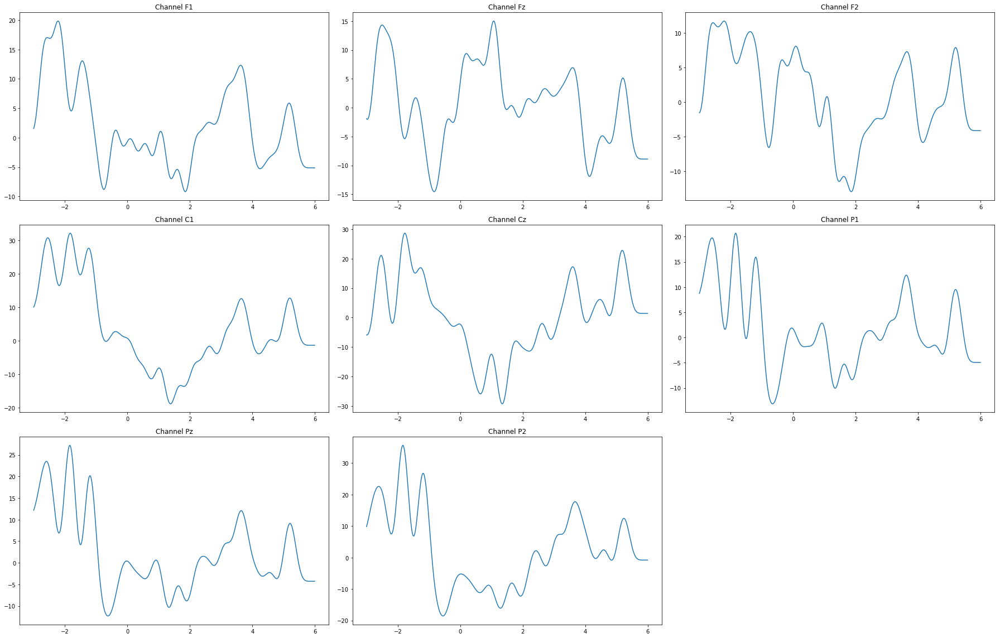

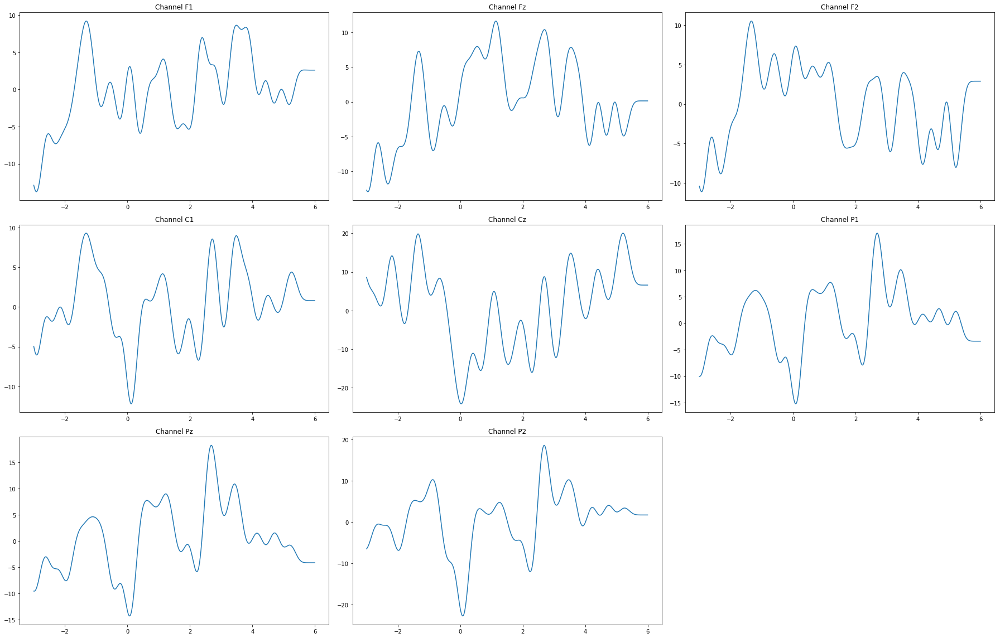

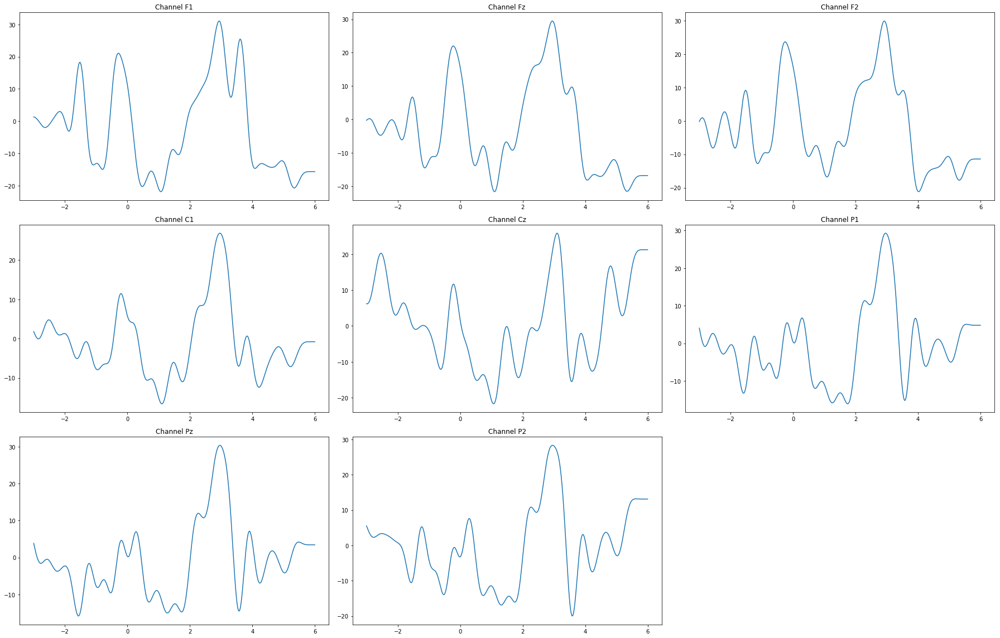

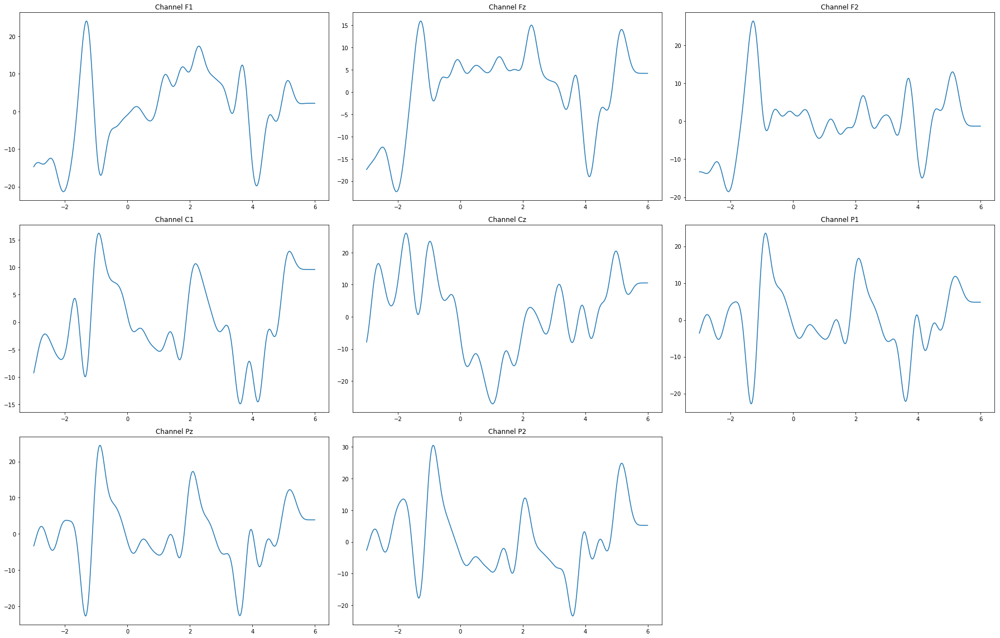

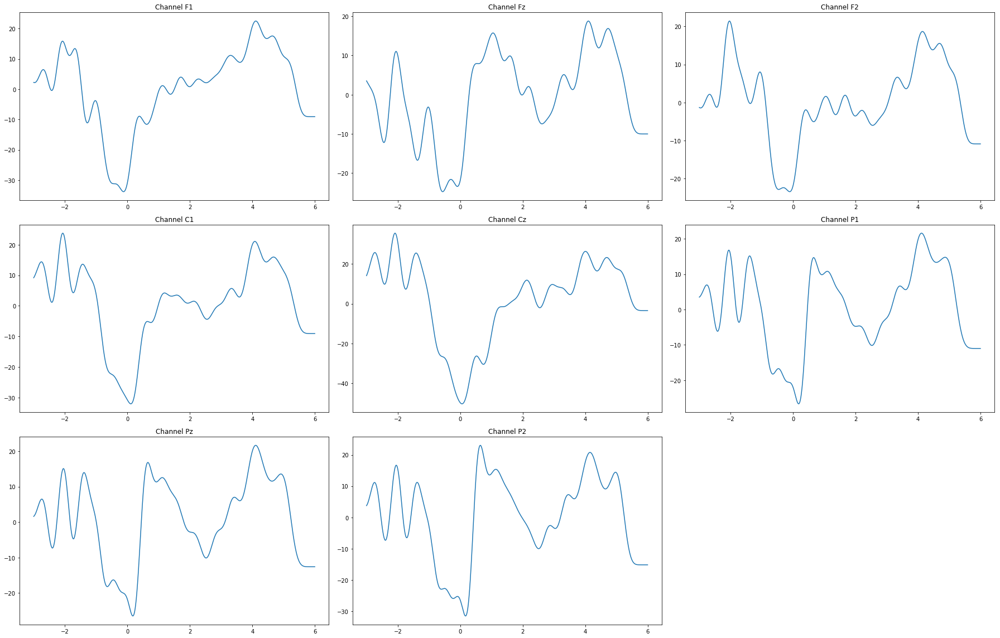

...

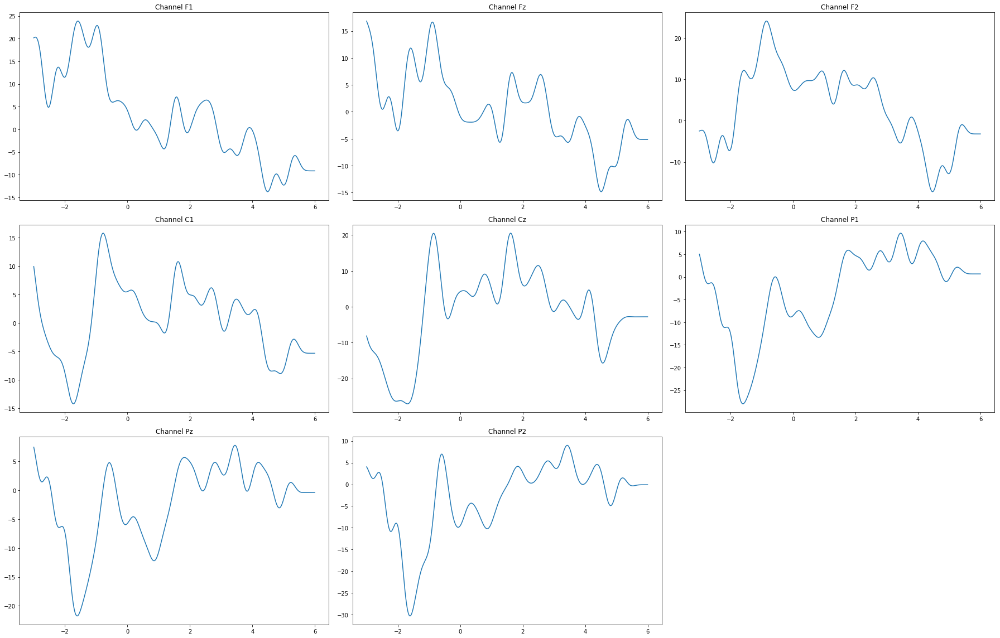

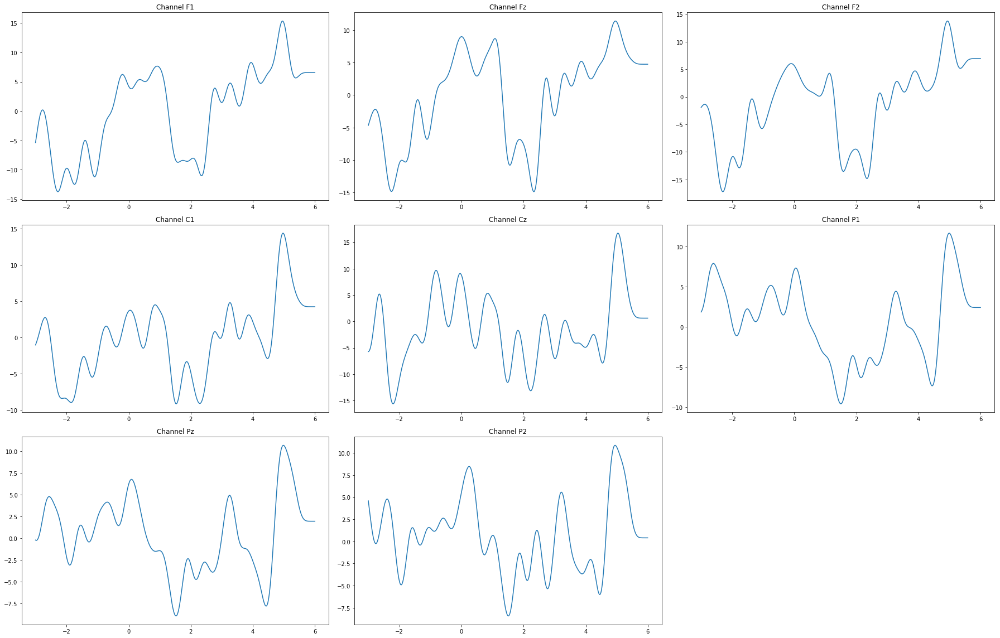

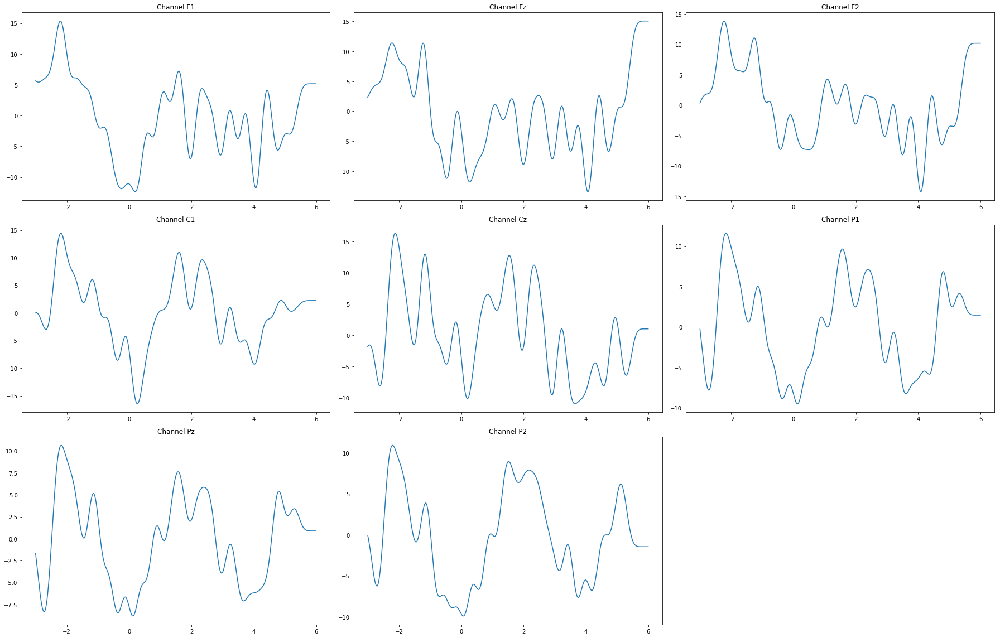

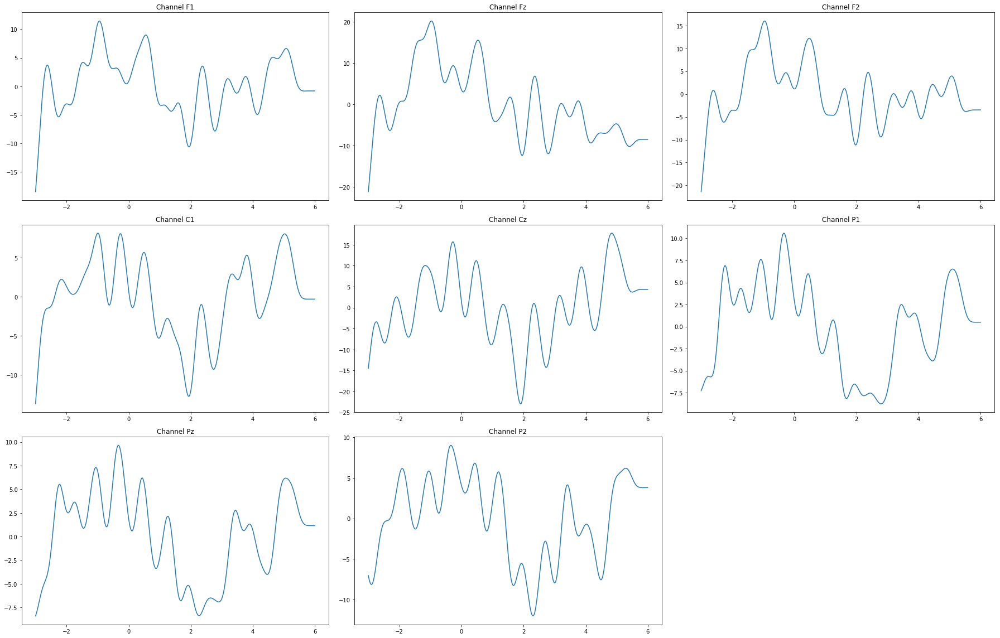

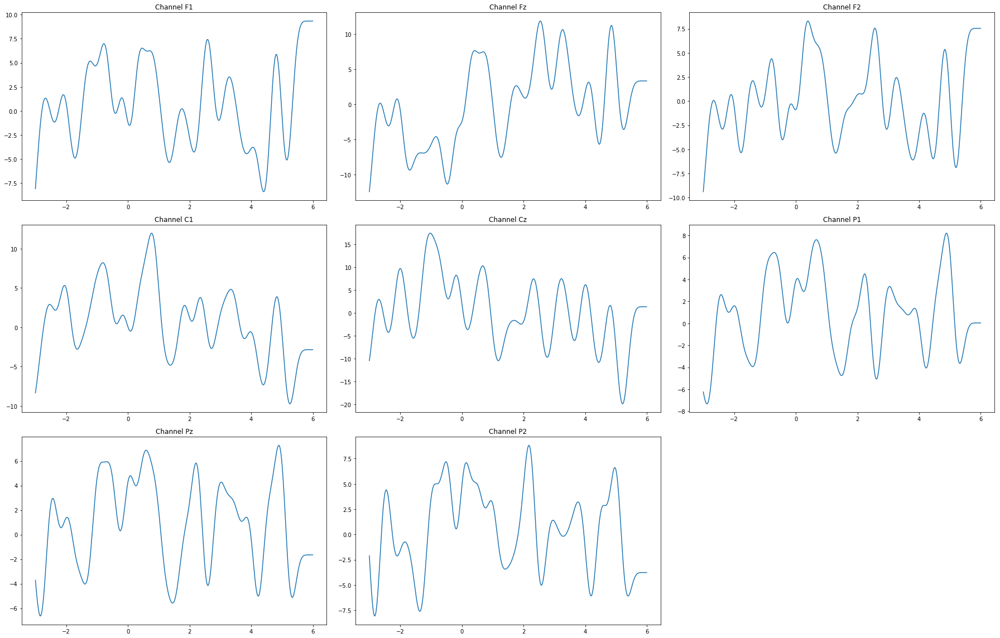

In [11]:
for f in efile:###MRCP after CAR , Baseline correction
    m=6.0
    n=3.0
    eeg=h5py.File(f,mode='r')
    sampletime = np.array(eeg['AsynchronData']["Time"])
    sampletime1=np.delete(sampletime, len(sampletime)-1)
    sampletime1=np.delete(sampletime1, 0)
    
    #if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <6.0 and (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0>=5.0:
        #sampletime1=np.delete(sampletime1, len(sampletime1)-1)
        #m=5.0
        
    if (eeg['RawData']['Samples'].shape[0]-sampletime1[len(sampletime1)-1])/256.0 <6.0:
        sampletime1=np.delete(sampletime1, len(sampletime1)-1)
    
    if sampletime1[0]/256.0 <=2.0:
        sampletime1=np.delete(sampletime1, 0)
    samples=np.array(eeg['RawData']['Samples'])
    samples=samples.T
    samples, _=CAR(samples)
    f1=samples[10]
    fz=samples[11]
    f2=samples[12]
    c1=samples[28]
    cz=samples[29]
    p1=samples[46]
    pz=samples[47]
    p2=samples[48]
    channels=[]
    channels.append(f1)
    channels.append(fz)
    channels.append(f2)
    channels.append(c1)
    channels.append(cz)
    channels.append(p1)
    channels.append(pz)
    channels.append(p2)
    fchannels=[]
    for i in range(0, len(channels)):
        c=[]
        for  j in sampletime1:
            c.append(channels[i][j-int(n)*256:j+int(m)*256])
        fchannels.append(c)
        
    filtered=fchannels
    freq=2
    fs=256
    order=8
    for i in range (0, len(fchannels)):
        for j in range(0, len(fchannels[i])):
            b, a= butter_bandpass(freq, fs, order)
            x=(signal.filtfilt(b, a, fchannels[i][j], padlen=0))
            #z= baseline_als(x, 10**4, 0.01, 10)
            #x=x*1.0/np.max(x)
            filtered[i][j]=x
            
    
    
    name=f[0:5]
    for j in range(0, len(filtered[0])):
        activity=f+'_'+str(j+1)
        fig = plt.figure()
        plot=fig.add_subplot(3,3,1)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[0][j])
        plt.title('Channel F1')

        plot=fig.add_subplot(3,3,2)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[1][j])
        plt.title('Channel Fz')

        plot=fig.add_subplot(3,3,3)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[2][j])
        plt.title('Channel F2')

        plot=fig.add_subplot(3,3,4)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[3][j])
        plt.title('Channel C1')


        plot=fig.add_subplot(3,3,5)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[4][j])
        plt.title('Channel Cz')

        plot=fig.add_subplot(3,3,6)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[5][j])
        plt.title('Channel P1')

        plot=fig.add_subplot(3,3,7)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[6][j])
        plt.title('Channel Pz')

        plot=fig.add_subplot(3,3,8)
        plt.plot(np.arange(-n, m, 1/256.0), filtered[7][j])
        plt.title('Channel P2')

        plt.tight_layout()
        plt.savefig(path+'/'+activity+'.png')